### 필요 라이브러리 import
---
사용할 패키지들을 import했습니다.

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from skimage.metrics import peak_signal_noise_ratio, structural_similarity
import imageio
from IPython.display import Image as show_gif

import tensorflow as tf

### SRGAN 모델 생성
---

In [8]:
model_file = 'srgan_G.h5'
srgan = tf.keras.models.load_model(model_file)

In [9]:
def apply_srgan(image):
    image = tf.cast(image[np.newaxis, ...], tf.float32)
    sr = srgan.predict(image)
    sr = tf.clip_by_value(sr, 0, 255)
    sr = tf.round(sr)
    sr = tf.cast(sr, tf.uint8)
    return np.array(sr)[0]

### 프로젝트 1-1
---
높은 해상도 이미지를 이용하여 가공 후 비교해보기

In [4]:
img = cv2.imread('home.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
print(img.shape)

(1600, 2560, 3)


In [81]:
## bicubic interpolation
bicubic_lr = cv2.resize(
    img, 
    dsize=(img.shape[1]//4, img.shape[0]//4), # 저해상도 이미지 크기로 설정
    interpolation=cv2.INTER_CUBIC # bicubic 설정
)

bicubic_hr = cv2.resize(
    bicubic_lr, 
    dsize=(img.shape[1], img.shape[0]), # 고해상도 이미지 크기로 설정
    interpolation=cv2.INTER_CUBIC # bicubic 설정
)

In [82]:
## SRGAN
sr = apply_srgan(bicubic_lr)

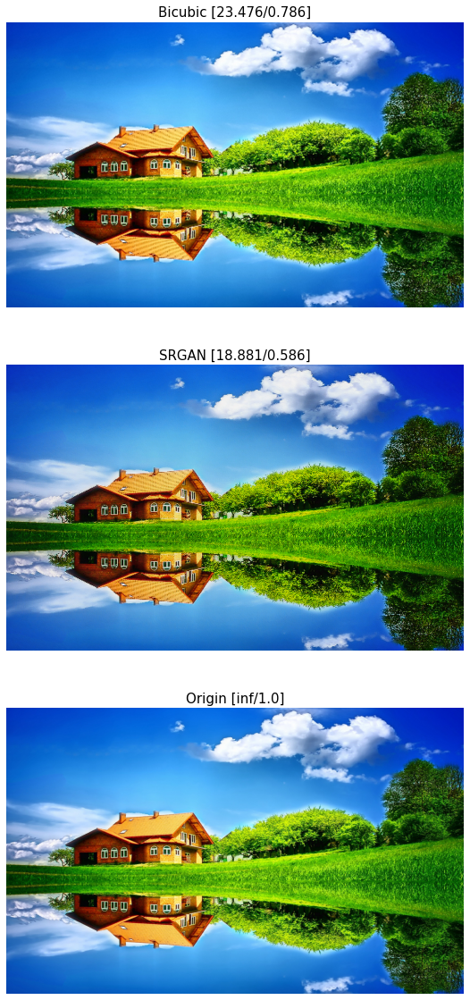

In [83]:
images = [bicubic_hr, sr, img]
labels = ["Bicubic", "SRGAN", "Origin"]

psnr = [round(peak_signal_noise_ratio(img, i), 3) for i in images]
ssim = [round(structural_similarity(img, i, multichannel=True), 3) for i in images]

plt.figure(figsize=(20, 20))
for i in range(3):
    plt.subplot(3,1,i+1) 
    plt.imshow(images[i])
    plt.title(labels[i] + f" [{psnr[i]}/{ssim[i]}]", fontsize=15)
    plt.axis('off')

### 프로젝트 1-2
---
낮은 해상도 이미지를 이용하여 가공 후 비교하기

(326, 580, 3)


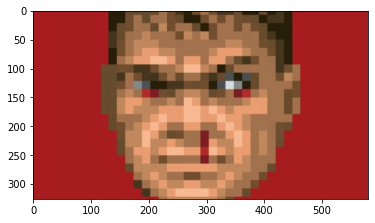

In [102]:

img_doom = cv2.imread('doomguy2.jpg')
img_doom = cv2.cvtColor(img_doom, cv2.COLOR_BGR2RGB)
print(img_doom.shape)
plt.imshow(img_doom)

In [103]:
## bicubic interpolation
bicubic_hr_doom = cv2.resize(
    img_doom, 
    dsize=(img_doom.shape[1]*4, img_doom.shape[0]*4), # 고해상도 이미지 크기로 설정
    interpolation=cv2.INTER_CUBIC # bicubic 설정
)
bicubic_hr_doom.shape

(1304, 2320, 3)

In [104]:
## SRGAN
sr_doom = apply_srgan(img_doom)

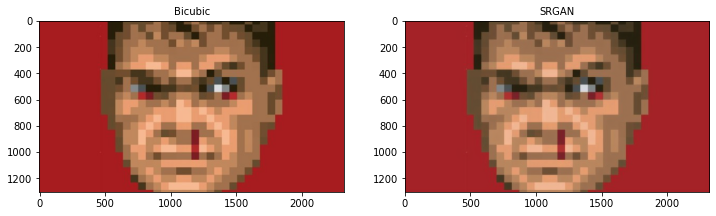

In [105]:
images_doom = [bicubic_hr_doom, sr_doom, img_doom]
labels = ["Bicubic", "SRGAN", "Origin"]

plt.figure(figsize=(12,12))

# psnr = [round(peak_signal_noise_ratio(img_doom, i), 3) for i in images_doom]
# ssim = [round(structural_similarity(img_doom, i, multichannel=True), 3) for i in images_doom]

for i in range(2):
    plt.subplot(1,2,i+1) 
    plt.imshow(images_doom[i])
    plt.title(labels[i], fontsize=10)
#     plt.title(labels[i] + f" [{psnr[i]}/{ssim[i]}]", fontsize=12)

둠가이 사진은 선을 넘은 것 같아서, 다른 사진을 이용해서 다시 시도했습니다.

(168, 300, 3)


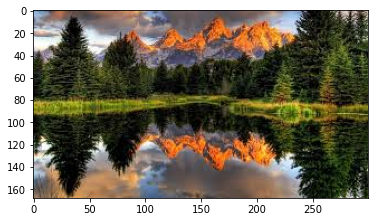

In [3]:
img_doom = cv2.imread('lowresBack.jfif')
img_doom = cv2.cvtColor(img_doom, cv2.COLOR_BGR2RGB)
print(img_doom.shape)
plt.imshow(img_doom)

In [53]:
## SRGAN
sr_doom = apply_srgan(img_doom)

In [55]:
## bicubic interpolation
bicubic_hr_doom = cv2.resize(
    img_doom, 
    dsize=(img_doom.shape[1]*4, img_doom.shape[0]*4), # 고해상도 이미지 크기로 설정
    interpolation=cv2.INTER_CUBIC # bicubic 설정
)

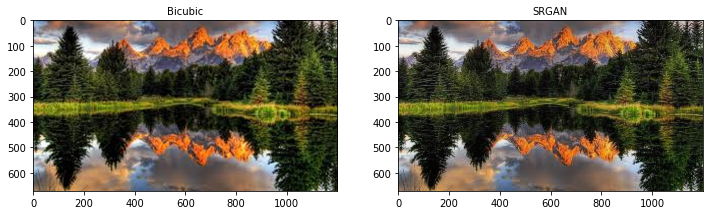

In [58]:
images_doom = [bicubic_hr_doom, sr_doom]
labels = ["Bicubic", "SRGAN"]

plt.figure(figsize=(12, 12))
for i in range(2):
    plt.subplot(1,2,i+1) 
    plt.imshow(images_doom[i])
    plt.title(labels[i], fontsize=10)

### 프로젝트2
---
고해상도 gif 생성하기

gif 파일 불러오기

In [15]:
gif = cv2.VideoCapture("book_lr.gif")

isTrue = True
frames = []
while isTrue:
    isTrue, frame = gif.read()
    if isTrue:
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        frames.append(frame)

print("frame 수 :", len(frames))
print("frame 크기 :", (frames[0].shape))

frame 수 : 22
frame 크기 : (215, 380, 3)


프레임별 Super Resolution 진행하기

In [16]:
## SRGAN
frames_srg = []
for f in frames:
    frames_srg.append(apply_srgan(f))

프레임을 합쳐 gif 만들기

In [17]:
imageio.mimsave("book_hr_srg.gif", frames_srg)

Jupyter notebook에 gif 표시하기

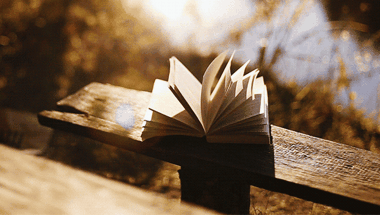

In [20]:
# 저해상도
show_gif("book_lr.gif", width=350)

깃허브에 안 나올경우 위해 이미지를 직접 첨가했습니다.\
저화질 gif\

![book_lr](https://user-images.githubusercontent.com/57059776/143403257-397b867a-b584-4b86-947b-7c998f0f90e9.gif)

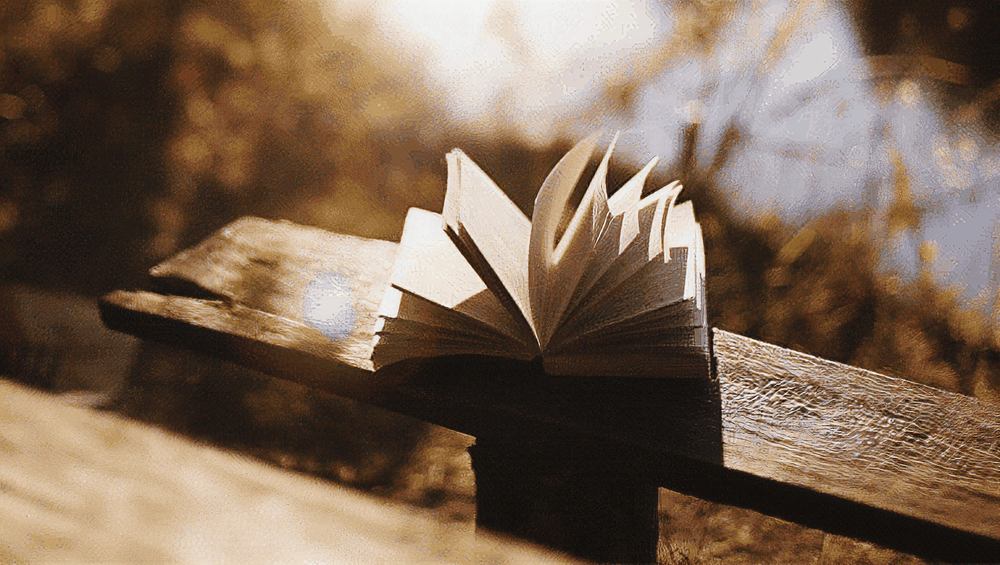

In [21]:
# 고해상도 SRGAN
show_gif("book_hr_srg.gif", width=350)

고화질 gif\

![book_hr](book_hr_srg.gif "book_hr")

---
안 될 경우, 구글링크 첨부
https://drive.google.com/file/d/1YkeyWzQxWXWcRtU34yWPpU1TlVW4WSiB/view?usp=sharing

### 회고
---
1-1 높은 해상도 이미지 가공

육안으로 지붕외의 큰 차이점을 발견할 수 없었습니다.\
srgan의 결과가 약간 더 어둡고 진한 색으로 표현되는 것은 확인 할 수 있었습니다.\
psnr과 ssim의 값 비교에서는 bicubic interpolation의 결과가 더 높게 측정되었습니다.

1-2 낮은 해상도 이미지 가공

기대했던 것은 네모 픽셀로 이루어진 얼굴이 조금이라도 조밀해지는 것이었지만,\
둠가이(둠2)의 얼굴에서 색조의 차이외에 원본하고 다른 점을 발견 할 수는 없었습니다.\

 그래서 다른 저해상도 사진을 이용했는데,\
육안으로 보기에는 색이 더 어두워지면서 물에비치는 산의 주름이 SRGAN이 더 많이\
보이는 것처럼 느껴졌습니다.\
(그림 크기의 차이로 psnr과 ssim은 확인하지 않았습니다)

2 고해상도 gif 이미지 생성

 색조의 차이로 변환이 이루어진 것은 확인됬지만,\
느껴지는 바로는, 오히려 색이 어두워져서 해상도가 낮아진 것처럼 느껴집니다.



